In [1]:
import turicreate as tc

In [2]:
img_folder = '/Users/Fox/Downloads/images_Ranks/Dog/'

In [3]:
data = tc.image_analysis.load_images(img_folder, with_path=True)

Read 4501 images in 5.00039 secs	speed: 900.13 file/sec

Read 8873 images in 10.0008 secs	speed: 874.32 file/sec

Read 13214 images in 15.0012 secs	speed: 868.134 file/sec

Read 17581 images in 20.0017 secs	speed: 873.32 file/sec

Read 21189 images in 25.0021 secs	speed: 721.544 file/sec

Read 25300 images in 30.0024 secs	speed: 822.146 file/sec

Read 29536 images in 35.003 secs	speed: 847.095 file/sec

In [4]:
data

path,image
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02 ...,Height: 480 Width: 477
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02 ...,Height: 480 Width: 270
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02 ...,Height: 480 Width: 270
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02 ...,Height: 628 Width: 640
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02 ...,Height: 480 Width: 270
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02 ...,Height: 400 Width: 300
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02 ...,Height: 300 Width: 400
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02 ...,Height: 400 Width: 300
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/03 ...,Height: 480 Width: 360
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/03 ...,Height: 480 Width: 360


In [5]:
# label the images by fast or slow
# data['label'] = data['path'].apply(lambda path: 'Fast' if 'Fast' in path else 'Slow')

In [6]:
# label the images
Alist = []
for i in data['path']:
    if 'Rank0' in i:
        Alist.append('Fast')
    elif 'Rank1' in i:
        Alist.append('Fast')    
    elif 'Rank2' in i:
        Alist.append('Fast')
    elif 'Rank3' in i:
        Alist.append('Slow')
    else:
        Alist.append('Slow')
data['label'] = Alist

In [7]:
data

path,image,label
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02 ...,Height: 480 Width: 477,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02 ...,Height: 480 Width: 270,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02 ...,Height: 480 Width: 270,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02 ...,Height: 628 Width: 640,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02 ...,Height: 480 Width: 270,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02 ...,Height: 400 Width: 300,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02 ...,Height: 300 Width: 400,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02 ...,Height: 400 Width: 300,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/03 ...,Height: 480 Width: 360,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/03 ...,Height: 480 Width: 360,Fast


In [23]:
F=[]
for i in data['label']:
    if i == 'Fast':
        F.append(i)
print('Number of Observations with Fast Label:',+ len(F))

print('Number of Observations with Slow Label:', + (len(data) - len(F)))

Number of Observations with Fast Label: 13804
Number of Observations with Slow Label: 16537


In [8]:
data.save('ranks.sframe')

/Users/Fox/opt/anaconda3/lib/python3.7/site-packages/turicreate/visualization/_plot.py:461: UserWarning: Displaying only the first 100 rows.
  warnings.warn("Displaying only the first {} rows.".format(maximum_rows))


,path,image,label
0,/Users/Fox/Downloads/images_Ranks/Dog/Rank0/022606901-1.jpg,,Fast
1,/Users/Fox/Downloads/images_Ranks/Dog/Rank0/022606901-2.jpg,,Fast
2,/Users/Fox/Downloads/images_Ranks/Dog/Rank0/022606901-3.jpg,,Fast
3,/Users/Fox/Downloads/images_Ranks/Dog/Rank0/022606901-4.jpg,,Fast
4,/Users/Fox/Downloads/images_Ranks/Dog/Rank0/022606901-5.jpg,,Fast
5,/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02f89bdcb-1.jpg,,Fast
6,/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02f89bdcb-2.jpg,,Fast
7,/Users/Fox/Downloads/images_Ranks/Dog/Rank0/02f89bdcb-3.jpg,,Fast
8,/Users/Fox/Downloads/images_Ranks/Dog/Rank0/03f217352-1.jpg,,Fast
9,/Users/Fox/Downloads/images_Ranks/Dog/Rank0/03f217352-2.jpg,,Fast

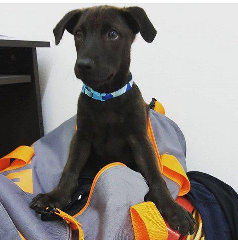
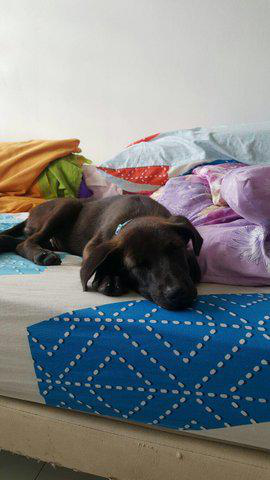
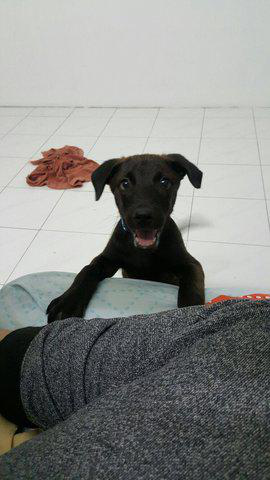
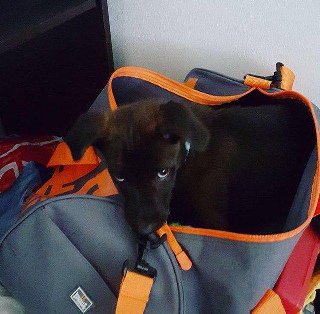
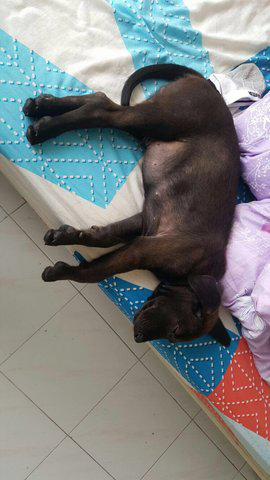
...
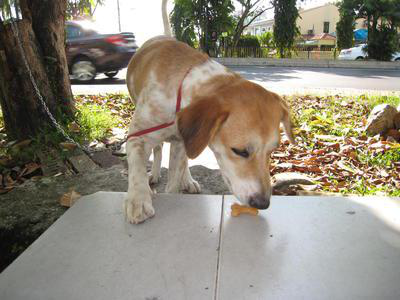
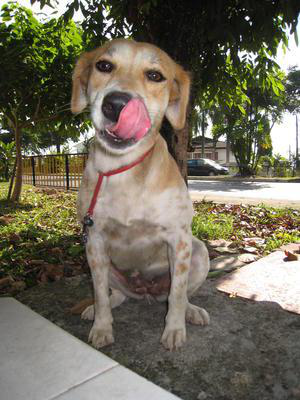
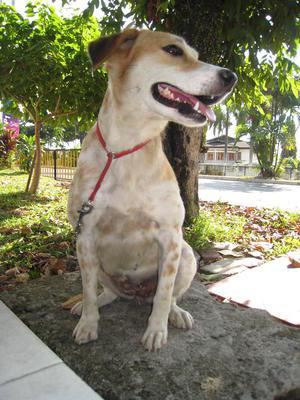
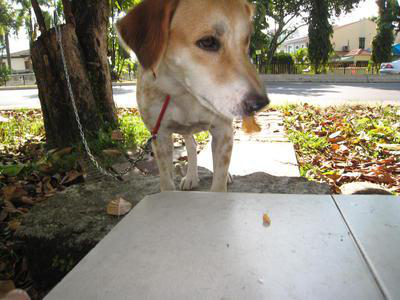
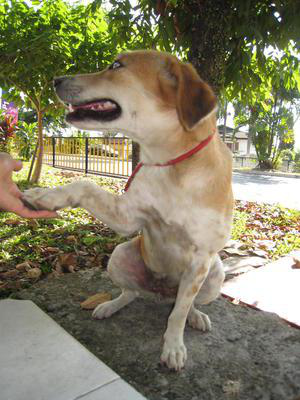

In [9]:
data.explore()

In [10]:
train_data, test_data = data.random_split(0.7, seed=3)

In [11]:
model = tc.image_classifier.create(train_data, target='label', max_iterations=350)

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 10.21s       | 0.25%            |

| 128              | 20.34s       | 0.5%             |

| 192              | 31.21s       | 0.75%            |

| 256              | 41.71s       | 1%               |

| 320              | 51.61s       | 1.5%             |

| 448              | 1m 11s       | 2%               |

| 512              | 1m 21s       | 2.25%            |

| 576              | 1m 31s       | 2.5%             |

| 640              | 1m 41s       | 3%               |

| 704              | 1m 52s       | 3.25%            |

| 768              | 2m 1s        | 3.5%             |

| 832              | 2m 11s       | 3.75%            |

| 896              | 2m 20s       | 4%               |

| 960              | 2m 30s       | 4.5%             |

| 1024             | 2m 39s       | 4.75%            |

| 1088             | 2m 48s       | 5%               |

| 1152             | 2m 57s       | 5.25%            |

| 1216             | 3m 6s        | 5.5%             |

| 1280             | 3m 16s       | 6%               |

| 1344             | 3m 25s       | 6.25%            |

| 1408             | 3m 34s       | 6.5%             |

| 1472             | 3m 43s       | 6.75%            |

| 1536             | 3m 52s       | 7%               |

| 1600             | 4m 2s        | 7.5%             |

| 1664             | 4m 11s       | 7.75%            |

| 1728             | 4m 20s       | 8%               |

| 1792             | 4m 29s       | 8.25%            |

| 1856             | 4m 39s       | 8.5%             |

| 1920             | 4m 48s       | 9%               |

| 1984             | 4m 57s       | 9.25%            |

| 2048             | 5m 6s        | 9.5%             |

| 2112             | 5m 15s       | 9.75%            |

| 2176             | 5m 24s       | 10%              |

| 2240             | 5m 33s       | 10.5%            |

| 2304             | 5m 43s       | 10.75%           |

| 2368             | 5m 52s       | 11%              |

| 2432             | 6m 1s        | 11.25%           |

| 2496             | 6m 10s       | 11.5%            |

| 2560             | 6m 19s       | 12%              |

| 2624             | 6m 28s       | 12.25%           |

| 2688             | 6m 37s       | 12.5%            |

| 2752             | 6m 46s       | 12.75%           |

| 2816             | 6m 56s       | 13%              |

| 2880             | 7m 5s        | 13.5%            |

| 2944             | 7m 14s       | 13.75%           |

| 3008             | 7m 23s       | 14%              |

| 3072             | 7m 32s       | 14.25%           |

| 3136             | 7m 41s       | 14.5%            |

| 3200             | 7m 50s       | 15%              |

| 3264             | 7m 59s       | 15.25%           |

| 3328             | 8m 8s        | 15.5%            |

| 3392             | 8m 18s       | 15.75%           |

| 3456             | 8m 27s       | 16%              |

| 3520             | 8m 36s       | 16.5%            |

| 3584             | 8m 45s       | 16.75%           |

| 3648             | 8m 54s       | 17%              |

| 3712             | 9m 3s        | 17.25%           |

| 3776             | 9m 12s       | 17.5%            |

| 3840             | 9m 21s       | 18%              |

| 3904             | 9m 30s       | 18.25%           |

| 3968             | 9m 39s       | 18.5%            |

| 4032             | 9m 48s       | 18.75%           |

| 4096             | 9m 57s       | 19%              |

| 4160             | 10m 6s       | 19.5%            |

| 4224             | 10m 16s      | 19.75%           |

| 4288             | 10m 26s      | 20%              |

| 4352             | 10m 35s      | 20.25%           |

| 4416             | 10m 44s      | 20.5%            |

| 4480             | 10m 53s      | 21%              |

| 4544             | 11m 2s       | 21.25%           |

| 4608             | 11m 11s      | 21.5%            |

| 4672             | 11m 20s      | 21.75%           |

| 4736             | 11m 29s      | 22%              |

| 4800             | 11m 38s      | 22.5%            |

| 4864             | 11m 47s      | 22.75%           |

| 4928             | 11m 56s      | 23%              |

| 4992             | 12m 5s       | 23.25%           |

| 5056             | 12m 14s      | 23.5%            |

| 5120             | 12m 23s      | 24%              |

| 5184             | 12m 32s      | 24.25%           |

| 5248             | 12m 41s      | 24.5%            |

| 5312             | 12m 50s      | 24.75%           |

| 5376             | 12m 59s      | 25%              |

| 5440             | 13m 8s       | 25.5%            |

| 5504             | 13m 17s      | 25.75%           |

| 5568             | 13m 26s      | 26%              |

| 5632             | 13m 35s      | 26.25%           |

| 5696             | 13m 44s      | 26.5%            |

| 5760             | 13m 53s      | 27%              |

| 5824             | 14m 2s       | 27.25%           |

| 5888             | 14m 11s      | 27.5%            |

| 5952             | 14m 20s      | 27.75%           |

| 6016             | 14m 29s      | 28%              |

| 6080             | 14m 38s      | 28.5%            |

| 6144             | 14m 47s      | 28.75%           |

| 6208             | 14m 56s      | 29%              |

| 6272             | 15m 5s       | 29.25%           |

| 6336             | 15m 14s      | 29.5%            |

| 6400             | 15m 23s      | 30%              |

| 6464             | 15m 32s      | 30.25%           |

| 6528             | 15m 41s      | 30.5%            |

| 6592             | 15m 50s      | 30.75%           |

| 6656             | 15m 59s      | 31%              |

| 6720             | 16m 8s       | 31.5%            |

| 6784             | 16m 18s      | 31.75%           |

| 6848             | 16m 26s      | 32%              |

| 6912             | 16m 35s      | 32.25%           |

| 6976             | 16m 44s      | 32.5%            |

| 7040             | 16m 53s      | 33%              |

| 7104             | 17m 2s       | 33.25%           |

| 7168             | 17m 11s      | 33.5%            |

| 7232             | 17m 20s      | 33.75%           |

| 7296             | 17m 29s      | 34%              |

| 7360             | 17m 38s      | 34.5%            |

| 7424             | 17m 47s      | 34.75%           |

| 7488             | 17m 56s      | 35%              |

| 7552             | 18m 5s       | 35.25%           |

| 7616             | 18m 14s      | 35.5%            |

| 7680             | 18m 23s      | 36%              |

| 7744             | 18m 32s      | 36.25%           |

| 7808             | 18m 41s      | 36.5%            |

| 7872             | 18m 50s      | 36.75%           |

| 7936             | 18m 59s      | 37%              |

| 8000             | 19m 8s       | 37.5%            |

| 8064             | 19m 17s      | 37.75%           |

| 8128             | 19m 26s      | 38%              |

| 8192             | 19m 35s      | 38.25%           |

| 8256             | 19m 44s      | 38.5%            |

| 8320             | 19m 53s      | 39%              |

| 8384             | 20m 3s       | 39.25%           |

| 8448             | 20m 12s      | 39.5%            |

| 8512             | 20m 22s      | 39.75%           |

| 8576             | 20m 31s      | 40%              |

| 8640             | 20m 41s      | 40.5%            |

| 8704             | 20m 50s      | 40.75%           |

| 8768             | 20m 59s      | 41%              |

| 8832             | 21m 8s       | 41.25%           |

| 8896             | 21m 17s      | 41.5%            |

| 8960             | 21m 26s      | 42%              |

| 9024             | 21m 35s      | 42.25%           |

| 9088             | 21m 45s      | 42.5%            |

| 9152             | 21m 57s      | 42.75%           |

| 9216             | 22m 9s       | 43%              |

| 9280             | 22m 22s      | 43.5%            |

| 9344             | 22m 33s      | 43.75%           |

| 9408             | 22m 45s      | 44%              |

| 9472             | 22m 57s      | 44.25%           |

| 9536             | 23m 8s       | 44.5%            |

| 9600             | 23m 20s      | 45%              |

| 9664             | 23m 32s      | 45.25%           |

| 9728             | 23m 44s      | 45.5%            |

| 9792             | 23m 56s      | 45.75%           |

| 9856             | 24m 7s       | 46%              |

| 9920             | 24m 20s      | 46.5%            |

| 9984             | 24m 32s      | 46.75%           |

| 10048            | 24m 43s      | 47%              |

| 10112            | 24m 55s      | 47.25%           |

| 10176            | 25m 6s       | 47.5%            |

| 10240            | 25m 18s      | 48%              |

| 10304            | 25m 30s      | 48.25%           |

| 10368            | 25m 42s      | 48.5%            |

| 10432            | 25m 54s      | 48.75%           |

| 10496            | 26m 5s       | 49%              |

| 10560            | 26m 18s      | 49.5%            |

| 10624            | 26m 30s      | 49.75%           |

| 10688            | 26m 41s      | 50%              |

| 10752            | 26m 53s      | 50.25%           |

| 10816            | 27m 5s       | 50.75%           |

| 10880            | 27m 16s      | 51%              |

| 10944            | 27m 28s      | 51.25%           |

| 11008            | 27m 40s      | 51.5%            |

| 11072            | 27m 52s      | 51.75%           |

| 11136            | 28m 3s       | 52.25%           |

| 11200            | 28m 15s      | 52.5%            |

| 11264            | 28m 27s      | 52.75%           |

| 11328            | 28m 40s      | 53%              |

| 11392            | 28m 52s      | 53.25%           |

| 11456            | 29m 4s       | 53.75%           |

| 11520            | 29m 15s      | 54%              |

| 11584            | 29m 27s      | 54.25%           |

| 11648            | 29m 39s      | 54.5%            |

| 11712            | 29m 50s      | 54.75%           |

| 11776            | 30m 2s       | 55.25%           |

| 11840            | 30m 15s      | 55.5%            |

| 11904            | 30m 27s      | 55.75%           |

| 11968            | 30m 39s      | 56%              |

| 12032            | 30m 50s      | 56.25%           |

| 12096            | 31m 2s       | 56.75%           |

| 12160            | 31m 14s      | 57%              |

| 12224            | 31m 26s      | 57.25%           |

| 12288            | 31m 38s      | 57.5%            |

| 12352            | 31m 49s      | 57.75%           |

| 12416            | 32m 0s       | 58.25%           |

| 12480            | 32m 10s      | 58.5%            |

| 12544            | 32m 31s      | 58.75%           |

| 12608            | 32m 41s      | 59%              |

| 12672            | 32m 51s      | 59.25%           |

| 12736            | 33m 1s       | 59.75%           |

| 12800            | 33m 11s      | 60%              |

| 12864            | 40m 37s      | 60.25%           |

| 12928            | 40m 45s      | 60.5%            |

| 12992            | 40m 53s      | 60.75%           |

| 13056            | 41m 1s       | 61.25%           |

| 13120            | 41m 8s       | 61.5%            |

| 13184            | 41m 16s      | 61.75%           |

| 13248            | 41m 24s      | 62%              |

| 13312            | 41m 32s      | 62.25%           |

| 13376            | 41m 41s      | 62.75%           |

| 13440            | 41m 50s      | 63%              |

| 13504            | 41m 59s      | 63.25%           |

| 13568            | 42m 9s       | 63.5%            |

| 13632            | 42m 19s      | 63.75%           |

| 13696            | 42m 29s      | 64.25%           |

| 13760            | 42m 38s      | 64.5%            |

| 13824            | 42m 46s      | 64.75%           |

| 13888            | 42m 54s      | 65%              |

| 13952            | 43m 2s       | 65.25%           |

| 14016            | 43m 11s      | 65.75%           |

| 14080            | 43m 19s      | 66%              |

| 14144            | 43m 28s      | 66.25%           |

| 14208            | 43m 37s      | 66.5%            |

| 14272            | 43m 46s      | 66.75%           |

| 14336            | 43m 55s      | 67.25%           |

| 14400            | 44m 3s       | 67.5%            |

| 14464            | 44m 12s      | 67.75%           |

| 14528            | 44m 20s      | 68%              |

| 14592            | 44m 29s      | 68.25%           |

| 14656            | 44m 38s      | 68.75%           |

| 14720            | 44m 47s      | 69%              |

| 14784            | 44m 56s      | 69.25%           |

| 14848            | 45m 5s       | 69.5%            |

| 14912            | 45m 14s      | 69.75%           |

| 14976            | 45m 23s      | 70.25%           |

| 15040            | 45m 33s      | 70.5%            |

| 15104            | 45m 42s      | 70.75%           |

| 15168            | 45m 51s      | 71%              |

| 15232            | 46m 0s       | 71.25%           |

| 15296            | 46m 9s       | 71.75%           |

| 15360            | 46m 18s      | 72%              |

| 15424            | 46m 27s      | 72.25%           |

| 15488            | 46m 36s      | 72.5%            |

| 15552            | 46m 45s      | 72.75%           |

| 15616            | 46m 54s      | 73.25%           |

| 15680            | 47m 3s       | 73.5%            |

| 15744            | 47m 13s      | 73.75%           |

| 15808            | 47m 22s      | 74%              |

| 15872            | 47m 31s      | 74.25%           |

| 15936            | 47m 41s      | 74.75%           |

| 16000            | 47m 50s      | 75%              |

| 16064            | 48m 0s       | 75.25%           |

| 16128            | 48m 9s       | 75.5%            |

| 16192            | 48m 18s      | 75.75%           |

| 16256            | 48m 27s      | 76.25%           |

| 16320            | 48m 36s      | 76.5%            |

| 16384            | 48m 46s      | 76.75%           |

| 16448            | 48m 55s      | 77%              |

| 16512            | 49m 5s       | 77.25%           |

| 16576            | 49m 14s      | 77.75%           |

| 16640            | 49m 24s      | 78%              |

| 16704            | 49m 33s      | 78.25%           |

| 16768            | 49m 42s      | 78.5%            |

| 16832            | 49m 52s      | 78.75%           |

| 16896            | 50m 1s       | 79.25%           |

| 16960            | 50m 11s      | 79.5%            |

| 17024            | 50m 21s      | 79.75%           |

| 17088            | 50m 30s      | 80%              |

| 17152            | 50m 39s      | 80.25%           |

| 17216            | 50m 48s      | 80.75%           |

| 17280            | 50m 57s      | 81%              |

| 17344            | 51m 6s       | 81.25%           |

| 17408            | 51m 15s      | 81.5%            |

| 17472            | 51m 25s      | 81.75%           |

| 17536            | 51m 35s      | 82.25%           |

| 17600            | 51m 44s      | 82.5%            |

| 17664            | 51m 53s      | 82.75%           |

| 17728            | 52m 2s       | 83%              |

| 17792            | 52m 11s      | 83.25%           |

| 17856            | 52m 20s      | 83.75%           |

| 17920            | 52m 29s      | 84%              |

| 17984            | 52m 38s      | 84.25%           |

| 18048            | 52m 47s      | 84.5%            |

| 18112            | 52m 56s      | 84.75%           |

| 18176            | 53m 5s       | 85.25%           |

| 18240            | 53m 13s      | 85.5%            |

| 18304            | 53m 23s      | 85.75%           |

| 18368            | 53m 33s      | 86%              |

| 18432            | 53m 43s      | 86.25%           |

| 18496            | 53m 52s      | 86.75%           |

| 18560            | 54m 2s       | 87%              |

| 18624            | 54m 12s      | 87.25%           |

| 18688            | 54m 23s      | 87.5%            |

| 18752            | 54m 32s      | 87.75%           |

| 18816            | 54m 42s      | 88.25%           |

| 18880            | 54m 52s      | 88.5%            |

| 18944            | 55m 1s       | 88.75%           |

| 19008            | 55m 11s      | 89%              |

| 19072            | 55m 21s      | 89.25%           |

| 19136            | 55m 31s      | 89.75%           |

| 19200            | 55m 41s      | 90%              |

| 19264            | 55m 52s      | 90.25%           |

| 19328            | 56m 2s       | 90.5%            |

| 19392            | 56m 11s      | 90.75%           |

| 19456            | 56m 20s      | 91.25%           |

| 19520            | 56m 29s      | 91.5%            |

| 19584            | 56m 38s      | 91.75%           |

| 19648            | 56m 48s      | 92%              |

| 19712            | 56m 57s      | 92.25%           |

| 19776            | 57m 6s       | 92.75%           |

| 19840            | 57m 15s      | 93%              |

| 19904            | 57m 25s      | 93.25%           |

| 19968            | 57m 35s      | 93.5%            |

| 20032            | 57m 45s      | 93.75%           |

| 20096            | 57m 55s      | 94.25%           |

| 20160            | 58m 4s       | 94.5%            |

| 20224            | 58m 13s      | 94.75%           |

| 20288            | 58m 22s      | 95%              |

| 20352            | 58m 32s      | 95.25%           |

| 20416            | 58m 42s      | 95.75%           |

| 20480            | 58m 52s      | 96%              |

| 20544            | 59m 2s       | 96.25%           |

| 20608            | 59m 11s      | 96.5%            |

| 20672            | 59m 20s      | 96.75%           |

| 20736            | 59m 29s      | 97.25%           |

| 20800            | 59m 39s      | 97.5%            |

| 20864            | 59m 48s      | 97.75%           |

| 20928            | 59m 58s      | 98%              |

| 20992            | 1h 0m        | 98.25%           |

| 21056            | 1h 0m        | 98.75%           |

| 21120            | 1h 0m        | 99%              |

| 21184            | 1h 0m        | 99.25%           |

| 21248            | 1h 0m        | 99.5%            |

| 21277            | 1h 0m        | 100%             |

+------------------+--------------+------------------+

PROGRESS: Creating a validation set from 5 percent of training data. This may take a while.
          You can set ``validation_set=None`` to disable validation tracking.



Logistic regression:

--------------------------------------------------------

Number of examples          : 20213

Number of classes           : 2

Number of feature columns   : 1

Number of unpacked features : 2048

Number of coefficients      : 2049

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 6        | 0.003042  | 3.773166     | 0.545589          | 0.546992            |

| 1         | 14       | 16.612359 | 10.113196    | 0.596052          | 0.597744            |

| 2         | 19       | 1.303914  | 14.746660    | 0.619799          | 0.626880            |

| 3         | 25       | 6.499710  | 19.726928    | 0.628309          | 0.646617            |

| 4         | 30       | 5.320761  | 25.296190    | 0.630238          | 0.634398            |

| 6         | 42       | 9.476398  | 33.492094    | 0.633107          | 0.631579            |

| 7         | 43       | 9.476398  | 34.901008    | 0.616435          | 0.603383            |

| 8         | 45       | 1.713893  | 37.268442    | 0.641023          | 0.640977            |

| 9         | 46       | 1.713893  | 38.587982    | 0.645525          | 0.637218            |

| 10        | 51       | 1.349659  | 41.914901    | 0.647949          | 0.640977            |

| 11        | 52       | 1.349659  | 43.161254    | 0.652204          | 0.624060            |

| 12        | 53       | 1.349659  | 45.090065    | 0.652056          | 0.637218            |

| 13        | 59       | 0.550466  | 49.663452    | 0.653243          | 0.632519            |

| 14        | 60       | 0.688083  | 50.945891    | 0.656310          | 0.637218            |

| 15        | 62       | 0.688083  | 52.847211    | 0.659031          | 0.633459            |

| 16        | 63       | 0.860103  | 54.226927    | 0.659229          | 0.621241            |

| 17        | 65       | 0.422778  | 56.072453    | 0.660812          | 0.637218            |

| 18        | 66       | 0.528472  | 57.617278    | 0.661109          | 0.637218            |

| 19        | 68       | 0.528472  | 59.653892    | 0.661653          | 0.633459            |

| 20        | 70       | 0.528472  | 61.728322    | 0.662791          | 0.632519            |

| 21        | 71       | 0.660590  | 63.568719    | 0.663731          | 0.622180            |

| 22        | 73       | 0.660590  | 66.564987    | 0.664078          | 0.624060            |

| 23        | 75       | 0.660590  | 69.016749    | 0.664968          | 0.620301            |

| 24        | 76       | 0.825737  | 70.597954    | 0.666304          | 0.625940            |

| 25        | 77       | 1.000000  | 72.237177    | 0.668035          | 0.618421            |

| 26        | 78       | 1.000000  | 73.907021    | 0.671499          | 0.610902            |

| 27        | 80       | 1.000000  | 76.313291    | 0.670410          | 0.597744            |

| 28        | 83       | 0.723289  | 79.180239    | 0.671301          | 0.596805            |

| 29        | 84       | 0.904111  | 80.765108    | 0.670806          | 0.593985            |

| 30        | 85       | 1.000000  | 82.226574    | 0.672636          | 0.591165            |

| 31        | 86       | 1.000000  | 83.729172    | 0.672735          | 0.601504            |

| 32        | 88       | 1.000000  | 85.855798    | 0.672834          | 0.593985            |

| 33        | 93       | 0.723677  | 92.009314    | 0.673873          | 0.594925            |

| 34        | 94       | 0.904596  | 94.093672    | 0.674022          | 0.599624            |

| 35        | 95       | 1.000000  | 95.673543    | 0.674220          | 0.602444            |

| 36        | 96       | 1.000000  | 97.491048    | 0.673873          | 0.603383            |

| 37        | 97       | 1.000000  | 99.222010    | 0.674764          | 0.608083            |

| 38        | 99       | 1.000000  | 101.607795   | 0.676644          | 0.608083            |

| 39        | 103      | 0.250000  | 105.447870   | 0.676990          | 0.612782            |

| 40        | 109      | 1.177321  | 110.398866   | 0.678524          | 0.608083            |

| 41        | 110      | 1.177321  | 112.114084   | 0.678227          | 0.601504            |

| 42        | 111      | 1.177321  | 113.856349   | 0.671894          | 0.619361            |

| 43        | 113      | 0.194999  | 116.320341   | 0.678722          | 0.608083            |

| 44        | 116      | 0.974994  | 119.396575   | 0.679315          | 0.612782            |

| 45        | 121      | 0.659796  | 124.407420   | 0.679266          | 0.608083            |

| 46        | 123      | 0.659796  | 126.599469   | 0.679216          | 0.607143            |

| 47        | 124      | 0.824745  | 128.141703   | 0.680057          | 0.605263            |

| 48        | 125      | 1.000000  | 129.698596   | 0.681443          | 0.605263            |

| 49        | 126      | 1.000000  | 132.295941   | 0.682284          | 0.609023            |

| 50        | 127      | 1.000000  | 134.264194   | 0.678821          | 0.608083            |

| 51        | 129      | 0.312397  | 137.127475   | 0.683075          | 0.609962            |

| 52        | 130      | 0.390496  | 139.438914   | 0.683422          | 0.612782            |

| 53        | 131      | 0.488120  | 141.381310   | 0.682976          | 0.615602            |

| 54        | 132      | 0.610150  | 142.981817   | 0.682828          | 0.619361            |

| 55        | 133      | 0.762688  | 144.569726   | 0.682036          | 0.620301            |

| 56        | 135      | 0.762688  | 147.013473   | 0.681987          | 0.620301            |

| 57        | 137      | 0.762688  | 150.445513   | 0.682630          | 0.620301            |

| 58        | 142      | 0.725934  | 155.211566   | 0.683224          | 0.614662            |

| 59        | 144      | 0.725934  | 158.196626   | 0.683817          | 0.613722            |

| 60        | 146      | 0.725934  | 162.802016   | 0.682927          | 0.614662            |

| 61        | 147      | 0.907417  | 164.648416   | 0.684263          | 0.617481            |

| 62        | 148      | 1.000000  | 166.400910   | 0.684559          | 0.612782            |

| 63        | 149      | 1.000000  | 168.161721   | 0.683619          | 0.616541            |

| 64        | 150      | 1.000000  | 169.934009   | 0.683273          | 0.614662            |

| 65        | 152      | 1.000000  | 171.964527   | 0.685796          | 0.623120            |

| 66        | 153      | 1.000000  | 173.372930   | 0.681146          | 0.633459            |

| 67        | 155      | 0.182264  | 175.296809   | 0.685203          | 0.625000            |

| 68        | 158      | 0.911319  | 177.740725   | 0.685895          | 0.625940            |

| 69        | 159      | 1.000000  | 179.023437   | 0.687033          | 0.620301            |

| 70        | 160      | 1.000000  | 180.471420   | 0.686538          | 0.622180            |

| 71        | 161      | 1.000000  | 181.837889   | 0.687182          | 0.625000            |

| 72        | 163      | 0.504249  | 183.782688   | 0.687825          | 0.622180            |

| 73        | 165      | 0.504249  | 186.160561   | 0.686736          | 0.619361            |

| 74        | 166      | 0.630311  | 188.475464   | 0.685846          | 0.618421            |

| 75        | 167      | 0.787889  | 190.696051   | 0.686588          | 0.614662            |

| 76        | 168      | 0.984861  | 192.739049   | 0.687280          | 0.615602            |

| 77        | 170      | 0.984861  | 194.915239   | 0.686637          | 0.618421            |

| 78        | 171      | 1.000000  | 196.776031   | 0.683323          | 0.620301            |

| 79        | 173      | 0.190526  | 199.028711   | 0.685747          | 0.622180            |

| 80        | 176      | 0.952631  | 201.823862   | 0.686093          | 0.621241            |

| 81        | 177      | 1.000000  | 203.909345   | 0.686538          | 0.620301            |

| 82        | 179      | 1.000000  | 206.971366   | 0.687676          | 0.612782            |

| 83        | 180      | 1.000000  | 209.039586   | 0.687132          | 0.617481            |

| 84        | 183      | 0.842420  | 212.495437   | 0.686538          | 0.615602            |

| 85        | 185      | 0.842420  | 216.331721   | 0.687083          | 0.617481            |

| 86        | 186      | 1.000000  | 217.943972   | 0.688072          | 0.615602            |

| 87        | 187      | 1.000000  | 219.389407   | 0.687429          | 0.615602            |

| 88        | 189      | 1.000000  | 221.845945   | 0.688369          | 0.619361            |

| 89        | 191      | 1.000000  | 224.194139   | 0.688319          | 0.618421            |

| 90        | 195      | 0.250000  | 227.521868   | 0.687083          | 0.622180            |

| 91        | 200      | 0.957126  | 231.295016   | 0.687379          | 0.619361            |

| 92        | 201      | 1.000000  | 232.729634   | 0.686687          | 0.620301            |

| 93        | 202      | 1.000000  | 234.157250   | 0.686934          | 0.621241            |

| 94        | 203      | 1.000000  | 235.969431   | 0.687676          | 0.623120            |

| 95        | 207      | 0.250000  | 238.899191   | 0.687726          | 0.621241            |

| 96        | 208      | 0.312500  | 240.163773   | 0.687676          | 0.622180            |

| 97        | 211      | 1.562500  | 242.857908   | 0.687874          | 0.613722            |

| 98        | 214      | 1.304655  | 245.378422   | 0.687726          | 0.617481            |

| 99        | 216      | 1.304655  | 247.305605   | 0.687379          | 0.617481            |

| 100       | 219      | 1.290685  | 249.793523   | 0.688418          | 0.615602            |

| 101       | 220      | 1.290685  | 251.303958   | 0.688715          | 0.622180            |

| 102       | 221      | 1.290685  | 252.731367   | 0.689952          | 0.628759            |

| 103       | 226      | 1.032454  | 256.340688   | 0.690298          | 0.622180            |

| 104       | 227      | 1.032454  | 257.782478   | 0.690199          | 0.606203            |

| 105       | 229      | 0.431138  | 259.684038   | 0.690496          | 0.613722            |

| 106       | 232      | 2.155688  | 262.054796   | 0.690843          | 0.615602            |

| 107       | 238      | 7.805774  | 266.047674   | 0.690843          | 0.618421            |

| 108       | 239      | 7.805774  | 267.495538   | 0.688864          | 0.613722            |

| 109       | 241      | 1.709865  | 269.397030   | 0.672587          | 0.600564            |

| 110       | 247      | 2.244025  | 274.173344   | 0.691040          | 0.617481            |

| 111       | 248      | 2.244025  | 275.721547   | 0.691684          | 0.623120            |

| 112       | 250      | 1.000000  | 277.783404   | 0.691783          | 0.617481            |

| 113       | 251      | 1.000000  | 279.615610   | 0.691634          | 0.613722            |

| 114       | 252      | 1.000000  | 281.124051   | 0.692525          | 0.615602            |

| 115       | 253      | 1.000000  | 283.852669   | 0.693662          | 0.617481            |

| 116       | 254      | 1.000000  | 285.428325   | 0.694108          | 0.619361            |

| 117       | 257      | 1.000000  | 288.685641   | 0.693959          | 0.615602            |

| 118       | 260      | 1.000000  | 291.332535   | 0.693860          | 0.617481            |

| 119       | 261      | 1.000000  | 292.834489   | 0.693564          | 0.623120            |

| 120       | 264      | 1.000000  | 295.796683   | 0.693316          | 0.619361            |

| 121       | 269      | 0.690963  | 299.985768   | 0.693514          | 0.618421            |

| 122       | 270      | 0.863704  | 302.455585   | 0.694256          | 0.620301            |

| 123       | 271      | 1.000000  | 304.134807   | 0.694157          | 0.617481            |

| 124       | 276      | 0.839242  | 308.473735   | 0.693860          | 0.617481            |

| 125       | 277      | 1.000000  | 309.946234   | 0.694306          | 0.617481            |

| 126       | 278      | 1.000000  | 311.421644   | 0.695246          | 0.617481            |

| 127       | 280      | 1.000000  | 313.427156   | 0.694800          | 0.619361            |

| 128       | 282      | 1.000000  | 315.566982   | 0.695097          | 0.617481            |

| 129       | 283      | 1.000000  | 317.073606   | 0.694256          | 0.602444            |

| 130       | 285      | 0.167795  | 319.049640   | 0.695592          | 0.621241            |

| 131       | 288      | 0.838974  | 321.766802   | 0.695147          | 0.615602            |

| 132       | 289      | 1.000000  | 323.128760   | 0.694553          | 0.615602            |

| 133       | 290      | 1.000000  | 324.471218   | 0.694405          | 0.615602            |

| 134       | 291      | 1.000000  | 325.894571   | 0.694751          | 0.614662            |

| 135       | 293      | 1.000000  | 327.774558   | 0.695295          | 0.615602            |

| 136       | 295      | 1.000000  | 329.600854   | 0.694850          | 0.624060            |

| 137       | 296      | 1.000000  | 331.458021   | 0.694701          | 0.627820            |

| 138       | 301      | 0.654235  | 336.007140   | 0.694850          | 0.625940            |

| 139       | 302      | 0.817794  | 337.373504   | 0.695345          | 0.625940            |

| 140       | 303      | 1.000000  | 338.626981   | 0.695542          | 0.625000            |

| 141       | 305      | 1.000000  | 340.729910   | 0.695493          | 0.618421            |

| 142       | 310      | 0.143471  | 344.434820   | 0.695097          | 0.619361            |

| 143       | 313      | 0.717355  | 346.985417   | 0.694701          | 0.616541            |

| 144       | 315      | 0.717355  | 348.903961   | 0.694256          | 0.617481            |

| 145       | 316      | 0.896694  | 350.338989   | 0.695147          | 0.617481            |

| 146       | 317      | 1.000000  | 352.062819   | 0.695493          | 0.621241            |

| 147       | 318      | 1.000000  | 353.800608   | 0.694899          | 0.621241            |

| 148       | 320      | 1.000000  | 356.012727   | 0.694355          | 0.621241            |

| 149       | 325      | 0.107897  | 360.447149   | 0.693712          | 0.618421            |

| 150       | 328      | 0.539484  | 364.038531   | 0.692970          | 0.617481            |

| 151       | 330      | 0.539484  | 366.025221   | 0.693662          | 0.617481            |

| 152       | 332      | 0.539484  | 367.888887   | 0.693761          | 0.616541            |

| 153       | 333      | 0.674354  | 369.217946   | 0.693415          | 0.617481            |

| 154       | 334      | 0.842943  | 371.024263   | 0.693662          | 0.618421            |

| 155       | 335      | 1.000000  | 372.495535   | 0.693415          | 0.617481            |

| 156       | 338      | 0.500000  | 375.406698   | 0.693910          | 0.616541            |

| 157       | 344      | 2.460575  | 380.763855   | 0.693564          | 0.617481            |

| 158       | 349      | 1.681574  | 384.722113   | 0.694355          | 0.619361            |

| 159       | 350      | 1.681574  | 386.056322   | 0.694157          | 0.622180            |

| 160       | 351      | 1.681574  | 387.585915   | 0.693514          | 0.623120            |

| 161       | 354      | 0.840787  | 390.308356   | 0.693217          | 0.620301            |

| 162       | 359      | 0.663827  | 395.405811   | 0.693811          | 0.623120            |

| 163       | 360      | 0.829784  | 397.091504   | 0.693910          | 0.623120            |

| 164       | 361      | 1.000000  | 398.604101   | 0.694454          | 0.622180            |

| 165       | 362      | 1.000000  | 400.054501   | 0.694207          | 0.621241            |

| 166       | 364      | 1.000000  | 402.012526   | 0.693564          | 0.619361            |

| 167       | 366      | 1.000000  | 403.971366   | 0.694899          | 0.616541            |

| 168       | 369      | 0.500000  | 406.756670   | 0.694454          | 0.616541            |

| 169       | 371      | 0.500000  | 408.925710   | 0.695196          | 0.614662            |

| 170       | 377      | 2.200642  | 413.299145   | 0.695542          | 0.615602            |

| 171       | 382      | 2.140852  | 417.558427   | 0.695938          | 0.613722            |

| 172       | 383      | 2.140852  | 419.193509   | 0.694009          | 0.617481            |

| 173       | 385      | 0.388248  | 421.431493   | 0.696433          | 0.614662            |

| 174       | 386      | 0.485309  | 423.253781   | 0.695938          | 0.611842            |

| 175       | 387      | 0.606637  | 424.774435   | 0.695740          | 0.613722            |

| 176       | 388      | 0.758296  | 426.066614   | 0.695493          | 0.616541            |

| 177       | 389      | 0.947870  | 427.425953   | 0.695889          | 0.615602            |

| 178       | 390      | 1.000000  | 428.727587   | 0.696532          | 0.617481            |

| 179       | 392      | 1.000000  | 430.718052   | 0.696433          | 0.617481            |

| 180       | 397      | 0.659476  | 434.366379   | 0.695641          | 0.615602            |

| 181       | 398      | 0.824345  | 435.640605   | 0.696186          | 0.612782            |

| 182       | 399      | 1.000000  | 436.850406   | 0.696779          | 0.614662            |

| 183       | 402      | 1.000000  | 439.382980   | 0.696977          | 0.612782            |

| 184       | 404      | 1.000000  | 441.357313   | 0.697324          | 0.612782            |

| 185       | 405      | 1.000000  | 443.134472   | 0.697422          | 0.612782            |

| 186       | 406      | 1.000000  | 444.538751   | 0.698066          | 0.614662            |

| 187       | 407      | 1.000000  | 446.398958   | 0.696878          | 0.610902            |

| 188       | 410      | 0.782534  | 448.754590   | 0.697126          | 0.611842            |

| 189       | 411      | 0.978168  | 450.067694   | 0.697027          | 0.611842            |

| 190       | 412      | 1.000000  | 451.870787   | 0.696829          | 0.611842            |

| 191       | 414      | 1.000000  | 453.685442   | 0.697225          | 0.613722            |

| 192       | 415      | 1.000000  | 454.943086   | 0.697670          | 0.609962            |

| 193       | 416      | 1.000000  | 456.210904   | 0.698412          | 0.611842            |

| 194       | 419      | 0.814126  | 458.555428   | 0.698214          | 0.611842            |

| 195       | 425      | 4.036825  | 462.870223   | 0.698214          | 0.609962            |

| 196       | 426      | 4.036825  | 464.282575   | 0.698511          | 0.610902            |

| 197       | 433      | 0.768109  | 469.347801   | 0.698263          | 0.609962            |

| 198       | 438      | 0.600265  | 473.065625   | 0.698165          | 0.609962            |

| 199       | 439      | 0.750331  | 474.434156   | 0.697719          | 0.610902            |

| 200       | 442      | 0.467493  | 476.996838   | 0.697917          | 0.609962            |

| 201       | 444      | 0.467493  | 478.944050   | 0.698066          | 0.610902            |

| 202       | 445      | 0.584366  | 480.345077   | 0.698461          | 0.610902            |

| 203       | 446      | 0.730458  | 482.175591   | 0.698362          | 0.609962            |

| 204       | 447      | 0.913072  | 483.716321   | 0.698362          | 0.610902            |

| 205       | 449      | 0.913072  | 485.697184   | 0.698560          | 0.612782            |

| 206       | 450      | 1.000000  | 487.065246   | 0.696878          | 0.608083            |

| 207       | 452      | 0.160104  | 489.419183   | 0.698461          | 0.609023            |

| 208       | 455      | 0.800520  | 493.057239   | 0.698165          | 0.610902            |

| 209       | 456      | 1.000000  | 494.730536   | 0.697967          | 0.609023            |

| 210       | 457      | 1.000000  | 496.434803   | 0.697917          | 0.612782            |

| 211       | 458      | 1.000000  | 497.932074   | 0.697967          | 0.614662            |

| 212       | 459      | 1.000000  | 500.143408   | 0.697076          | 0.610902            |

| 213       | 461      | 0.477356  | 502.713955   | 0.697868          | 0.610902            |

| 214       | 463      | 0.477356  | 504.603961   | 0.697670          | 0.610902            |

| 215       | 464      | 0.596695  | 506.520055   | 0.697175          | 0.609962            |

| 216       | 465      | 0.745868  | 507.923661   | 0.697225          | 0.609962            |

| 217       | 466      | 0.932335  | 509.461819   | 0.696928          | 0.608083            |

| 218       | 468      | 0.932335  | 511.407405   | 0.697670          | 0.609023            |

| 219       | 473      | 0.023069  | 515.615762   | 0.697422          | 0.608083            |

| 220       | 477      | 0.484441  | 518.819295   | 0.697472          | 0.609962            |

| 221       | 479      | 0.484441  | 521.048101   | 0.697175          | 0.609962            |

| 222       | 481      | 0.484441  | 523.192169   | 0.697175          | 0.610902            |

| 223       | 482      | 0.605552  | 524.925022   | 0.697274          | 0.611842            |

| 224       | 483      | 0.756940  | 526.388069   | 0.697373          | 0.607143            |

| 225       | 484      | 0.946175  | 527.690049   | 0.697274          | 0.609962            |

| 226       | 485      | 1.000000  | 529.038199   | 0.697324          | 0.608083            |

| 227       | 488      | 0.645916  | 531.524718   | 0.697076          | 0.609962            |

| 228       | 490      | 0.645916  | 533.602067   | 0.697719          | 0.608083            |

| 229       | 491      | 0.807395  | 535.271711   | 0.698165          | 0.609962            |

| 230       | 492      | 1.000000  | 536.724060   | 0.698263          | 0.609962            |

| 231       | 494      | 1.000000  | 539.456515   | 0.697076          | 0.608083            |

| 232       | 495      | 1.000000  | 540.924704   | 0.698263          | 0.609023            |

| 233       | 496      | 1.000000  | 542.429240   | 0.697967          | 0.608083            |

| 234       | 497      | 1.000000  | 544.096547   | 0.698214          | 0.608083            |

| 235       | 498      | 1.000000  | 546.037602   | 0.698214          | 0.606203            |

| 236       | 500      | 1.000000  | 548.199229   | 0.698165          | 0.608083            |

| 237       | 502      | 1.000000  | 550.241330   | 0.698066          | 0.607143            |

| 238       | 503      | 1.000000  | 551.673705   | 0.697670          | 0.607143            |

| 239       | 504      | 1.000000  | 553.230162   | 0.697670          | 0.608083            |

| 240       | 505      | 1.000000  | 554.762949   | 0.697719          | 0.608083            |

| 241       | 506      | 1.000000  | 556.281428   | 0.698165          | 0.606203            |

| 242       | 509      | 0.932697  | 559.030925   | 0.698066          | 0.608083            |

| 243       | 510      | 1.000000  | 560.401936   | 0.698066          | 0.607143            |

| 244       | 515      | 0.793922  | 563.934413   | 0.698659          | 0.609962            |

| 245       | 521      | 3.272140  | 568.093590   | 0.698263          | 0.608083            |

| 246       | 522      | 3.272140  | 569.456871   | 0.698165          | 0.608083            |

| 247       | 523      | 3.272140  | 571.226262   | 0.697917          | 0.607143            |

| 248       | 525      | 0.663577  | 573.151789   | 0.698214          | 0.606203            |

| 249       | 526      | 0.829471  | 574.434049   | 0.698461          | 0.607143            |

| 250       | 527      | 1.000000  | 576.875688   | 0.698066          | 0.609023            |

| 251       | 529      | 0.520446  | 579.091602   | 0.698956          | 0.608083            |

| 252       | 530      | 0.650558  | 580.824847   | 0.698758          | 0.608083            |

| 253       | 531      | 0.813197  | 582.253116   | 0.698907          | 0.608083            |

| 254       | 532      | 1.000000  | 583.636699   | 0.698857          | 0.607143            |

| 255       | 533      | 1.000000  | 584.966123   | 0.698066          | 0.609023            |

| 256       | 539      | 0.404126  | 589.209396   | 0.697868          | 0.610902            |

| 257       | 541      | 0.464620  | 591.096944   | 0.697719          | 0.610902            |

| 258       | 543      | 0.464620  | 593.257858   | 0.697769          | 0.609962            |

| 259       | 544      | 0.580775  | 595.220504   | 0.697324          | 0.611842            |

| 260       | 545      | 0.725969  | 596.512709   | 0.697126          | 0.609962            |

| 261       | 551      | 2.538977  | 600.935502   | 0.697422          | 0.610902            |

| 262       | 554      | 1.941058  | 604.049213   | 0.697422          | 0.611842            |

| 263       | 555      | 1.941058  | 605.415308   | 0.697324          | 0.609962            |

| 264       | 557      | 0.465214  | 607.307299   | 0.697373          | 0.609962            |

| 265       | 559      | 0.465214  | 609.289410   | 0.697126          | 0.609023            |

| 266       | 560      | 0.581517  | 611.052300   | 0.697274          | 0.610902            |

| 267       | 561      | 0.726897  | 612.556506   | 0.697175          | 0.609962            |

| 268       | 562      | 0.908621  | 614.019683   | 0.697076          | 0.610902            |

| 269       | 564      | 0.194880  | 616.111090   | 0.697126          | 0.610902            |

| 270       | 567      | 0.974400  | 618.857501   | 0.697126          | 0.605263            |

| 271       | 568      | 1.000000  | 620.356544   | 0.697422          | 0.608083            |

| 272       | 569      | 1.000000  | 621.826881   | 0.697126          | 0.608083            |

| 273       | 570      | 1.000000  | 623.209630   | 0.696977          | 0.609962            |

| 274       | 572      | 0.484195  | 625.059554   | 0.697076          | 0.606203            |

| 275       | 574      | 0.484195  | 626.841736   | 0.697274          | 0.607143            |

| 276       | 575      | 0.605244  | 628.130831   | 0.697027          | 0.608083            |

| 277       | 576      | 0.756555  | 629.385263   | 0.696384          | 0.610902            |

| 278       | 577      | 0.945694  | 630.645919   | 0.696631          | 0.610902            |

| 279       | 578      | 1.000000  | 633.025407   | 0.696928          | 0.611842            |

| 280       | 579      | 1.000000  | 634.602029   | 0.696730          | 0.610902            |

| 281       | 580      | 1.000000  | 635.843909   | 0.698560          | 0.609962            |

| 282       | 582      | 0.147054  | 637.645940   | 0.696680          | 0.609023            |

| 283       | 585      | 0.735271  | 641.078828   | 0.696779          | 0.609023            |

| 284       | 590      | 0.678111  | 644.605425   | 0.696977          | 0.609962            |

| 285       | 592      | 0.678111  | 646.388219   | 0.697373          | 0.609962            |

| 286       | 593      | 0.847639  | 647.621172   | 0.697620          | 0.610902            |

| 287       | 594      | 1.000000  | 648.885390   | 0.697769          | 0.609962            |

| 288       | 595      | 1.000000  | 650.173098   | 0.697126          | 0.609023            |

| 289       | 600      | 0.789459  | 653.519914   | 0.697620          | 0.608083            |

| 290       | 602      | 0.719752  | 655.404494   | 0.697620          | 0.609023            |

| 291       | 603      | 0.899691  | 656.701278   | 0.697422          | 0.609962            |

| 292       | 604      | 1.000000  | 657.926867   | 0.697422          | 0.609962            |

| 293       | 606      | 1.000000  | 659.722959   | 0.697719          | 0.609962            |

| 294       | 608      | 1.000000  | 662.238543   | 0.698016          | 0.610902            |

| 295       | 611      | 1.000000  | 665.745378   | 0.697917          | 0.610902            |

| 296       | 613      | 1.000000  | 667.638571   | 0.698214          | 0.609023            |

| 297       | 614      | 1.000000  | 668.940370   | 0.698165          | 0.609023            |

| 298       | 616      | 1.000000  | 670.887399   | 0.697917          | 0.610902            |

| 299       | 617      | 1.000000  | 672.184463   | 0.697719          | 0.609023            |

| 300       | 618      | 1.000000  | 673.492525   | 0.697670          | 0.609023            |

| 301       | 619      | 1.000000  | 674.754944   | 0.698115          | 0.609023            |

| 302       | 621      | 1.000000  | 676.656343   | 0.697967          | 0.609962            |

| 303       | 622      | 1.000000  | 678.079985   | 0.697670          | 0.609023            |

| 304       | 625      | 0.701199  | 681.390180   | 0.697620          | 0.609023            |

| 305       | 626      | 0.876498  | 682.849704   | 0.697472          | 0.609962            |

| 306       | 627      | 1.000000  | 684.174327   | 0.697967          | 0.609962            |

| 307       | 629      | 0.600553  | 686.461196   | 0.697670          | 0.610902            |

| 308       | 630      | 0.750691  | 687.959671   | 0.697719          | 0.610902            |

| 309       | 631      | 0.938363  | 689.400837   | 0.697472          | 0.611842            |

| 310       | 632      | 1.000000  | 691.300346   | 0.697620          | 0.609962            |

| 311       | 633      | 1.000000  | 692.693037   | 0.697521          | 0.609962            |

| 312       | 638      | 0.699256  | 696.750671   | 0.697769          | 0.609962            |

| 313       | 639      | 0.874070  | 697.925799   | 0.697967          | 0.610902            |

| 314       | 640      | 1.000000  | 699.262500   | 0.698263          | 0.610902            |

| 315       | 641      | 1.000000  | 700.530926   | 0.698263          | 0.609023            |

| 316       | 646      | 0.639740  | 703.944563   | 0.698313          | 0.609962            |

| 317       | 647      | 0.799676  | 705.214110   | 0.698066          | 0.609962            |

| 318       | 648      | 0.999594  | 706.482566   | 0.698165          | 0.610902            |

| 319       | 649      | 1.000000  | 707.775455   | 0.697868          | 0.609962            |

| 320       | 651      | 1.000000  | 709.769562   | 0.697769          | 0.609962            |

| 321       | 652      | 1.000000  | 711.039005   | 0.697620          | 0.610902            |

| 322       | 653      | 1.000000  | 712.275993   | 0.697571          | 0.610902            |

| 323       | 654      | 1.000000  | 713.745743   | 0.697126          | 0.610902            |

| 324       | 657      | 1.000000  | 716.144657   | 0.697324          | 0.610902            |

| 325       | 659      | 1.000000  | 717.979850   | 0.697324          | 0.609962            |

| 326       | 661      | 1.000000  | 720.277744   | 0.696928          | 0.610902            |

| 327       | 662      | 1.000000  | 721.899154   | 0.697225          | 0.609962            |

| 328       | 663      | 1.000000  | 723.310513   | 0.698016          | 0.610902            |

| 329       | 665      | 0.685208  | 725.328366   | 0.697422          | 0.610902            |

| 330       | 666      | 0.856510  | 726.681919   | 0.697719          | 0.609962            |

| 331       | 667      | 1.000000  | 728.177430   | 0.697126          | 0.612782            |

| 332       | 669      | 0.217698  | 730.263213   | 0.697472          | 0.609962            |

| 333       | 672      | 1.088488  | 732.976931   | 0.697620          | 0.609962            |

| 334       | 673      | 1.088488  | 734.409023   | 0.697868          | 0.609023            |

| 335       | 674      | 1.088488  | 735.839494   | 0.698362          | 0.609023            |

| 336       | 675      | 1.088488  | 737.377298   | 0.698362          | 0.608083            |

| 337       | 677      | 0.273755  | 739.482431   | 0.698461          | 0.607143            |

| 338       | 680      | 1.368777  | 742.695806   | 0.697967          | 0.608083            |

| 339       | 685      | 1.269937  | 747.062968   | 0.697719          | 0.607143            |

| 340       | 688      | 0.634969  | 749.753650   | 0.697571          | 0.607143            |

| 341       | 689      | 0.793711  | 751.258154   | 0.697967          | 0.606203            |

| 342       | 690      | 0.992138  | 752.578569   | 0.698016          | 0.606203            |

| 343       | 691      | 1.000000  | 753.927924   | 0.698362          | 0.607143            |

| 344       | 692      | 1.000000  | 755.213679   | 0.698758          | 0.609962            |

| 345       | 696      | 0.452886  | 758.273708   | 0.698362          | 0.608083            |

| 346       | 698      | 0.452886  | 760.144928   | 0.698362          | 0.608083            |

| 347       | 699      | 0.566107  | 761.467768   | 0.698165          | 0.607143            |

| 348       | 700      | 0.707634  | 762.850413   | 0.698214          | 0.607143            |

| 349       | 701      | 0.884542  | 764.225752   | 0.697620          | 0.606203            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

In [22]:
model.save('turicreate-dog-FS-whole')

In [12]:
predictions = model.predict(test_data)

In [13]:
metrics = model.evaluate(test_data)
print(metrics['accuracy'])

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 9.33s        | 0.5%             |

| 128              | 18.59s       | 1.25%            |

| 192              | 27.61s       | 2%               |

| 256              | 36.85s       | 2.75%            |

| 320              | 46.23s       | 3.5%             |

| 448              | 1m 4s        | 4.75%            |

| 512              | 1m 13s       | 5.5%             |

| 576              | 1m 23s       | 6.25%            |

| 640              | 1m 32s       | 7%               |

| 704              | 1m 41s       | 7.5%             |

| 768              | 1m 50s       | 8.25%            |

| 832              | 1m 59s       | 9%               |

| 896              | 2m 8s        | 9.75%            |

| 960              | 2m 17s       | 10.5%            |

| 1024             | 2m 27s       | 11.25%           |

| 1088             | 2m 36s       | 11.75%           |

| 1152             | 2m 45s       | 12.5%            |

| 1216             | 2m 55s       | 13.25%           |

| 1280             | 3m 4s        | 14%              |

| 1344             | 3m 14s       | 14.75%           |

| 1408             | 3m 23s       | 15.25%           |

| 1472             | 3m 32s       | 16%              |

| 1536             | 3m 41s       | 16.75%           |

| 1600             | 3m 50s       | 17.5%            |

| 1664             | 4m 0s        | 18.25%           |

| 1728             | 4m 9s        | 19%              |

| 1792             | 4m 18s       | 19.5%            |

| 1856             | 4m 28s       | 20.25%           |

| 1920             | 4m 37s       | 21%              |

| 1984             | 4m 47s       | 21.75%           |

| 2048             | 4m 57s       | 22.5%            |

| 2112             | 5m 7s        | 23%              |

| 2176             | 5m 18s       | 23.75%           |

| 2240             | 5m 28s       | 24.5%            |

| 2304             | 5m 38s       | 25.25%           |

| 2368             | 5m 48s       | 26%              |

| 2432             | 5m 58s       | 26.75%           |

| 2496             | 6m 7s        | 27.25%           |

| 2560             | 6m 18s       | 28%              |

| 2624             | 6m 27s       | 28.75%           |

| 2688             | 6m 36s       | 29.5%            |

| 2752             | 6m 46s       | 30.25%           |

| 2816             | 6m 55s       | 30.75%           |

| 2880             | 7m 5s        | 31.5%            |

| 2944             | 7m 14s       | 32.25%           |

| 3008             | 7m 23s       | 33%              |

| 3072             | 7m 33s       | 33.75%           |

| 3136             | 7m 43s       | 34.5%            |

| 3200             | 7m 52s       | 35%              |

| 3264             | 8m 1s        | 35.75%           |

| 3328             | 8m 10s       | 36.5%            |

| 3392             | 8m 19s       | 37.25%           |

| 3456             | 8m 28s       | 38%              |

| 3520             | 8m 38s       | 38.5%            |

| 3584             | 8m 47s       | 39.25%           |

| 3648             | 8m 57s       | 40%              |

| 3712             | 9m 6s        | 40.75%           |

| 3776             | 9m 15s       | 41.5%            |

| 3840             | 9m 25s       | 42.25%           |

| 3904             | 9m 34s       | 42.75%           |

| 3968             | 9m 43s       | 43.5%            |

| 4032             | 9m 54s       | 44.25%           |

| 4096             | 10m 5s       | 45%              |

| 4160             | 10m 15s      | 45.75%           |

| 4224             | 10m 25s      | 46.25%           |

| 4288             | 10m 35s      | 47%              |

| 4352             | 10m 45s      | 47.75%           |

| 4416             | 10m 56s      | 48.5%            |

| 4480             | 11m 6s       | 49.25%           |

| 4544             | 11m 15s      | 50%              |

| 4608             | 11m 24s      | 50.5%            |

| 4672             | 11m 34s      | 51.25%           |

| 4736             | 11m 43s      | 52%              |

| 4800             | 11m 53s      | 52.75%           |

| 4864             | 12m 2s       | 53.5%            |

| 4928             | 12m 11s      | 54%              |

| 4992             | 12m 20s      | 54.75%           |

| 5056             | 12m 30s      | 55.5%            |

| 5120             | 12m 39s      | 56.25%           |

| 5184             | 12m 49s      | 57%              |

| 5248             | 12m 59s      | 57.5%            |

| 5312             | 13m 8s       | 58.25%           |

| 5376             | 13m 17s      | 59%              |

| 5440             | 13m 27s      | 59.75%           |

| 5504             | 13m 36s      | 60.5%            |

| 5568             | 13m 45s      | 61.25%           |

| 5632             | 13m 54s      | 61.75%           |

| 5696             | 14m 3s       | 62.5%            |

| 5760             | 14m 12s      | 63.25%           |

| 5824             | 14m 21s      | 64%              |

| 5888             | 14m 30s      | 64.75%           |

| 5952             | 14m 40s      | 65.25%           |

| 6016             | 14m 49s      | 66%              |

| 6080             | 14m 58s      | 66.75%           |

| 6144             | 15m 7s       | 67.5%            |

| 6208             | 15m 16s      | 68.25%           |

| 6272             | 15m 25s      | 69%              |

| 6336             | 15m 34s      | 69.5%            |

| 6400             | 15m 44s      | 70.25%           |

| 6464             | 15m 53s      | 71%              |

| 6528             | 16m 2s       | 71.75%           |

| 6592             | 16m 11s      | 72.5%            |

| 6656             | 16m 20s      | 73%              |

| 6720             | 16m 29s      | 73.75%           |

| 6784             | 16m 38s      | 74.5%            |

| 6848             | 16m 47s      | 75.25%           |

| 6912             | 16m 56s      | 76%              |

| 6976             | 17m 5s       | 76.75%           |

| 7040             | 17m 14s      | 77.25%           |

| 7104             | 17m 23s      | 78%              |

| 7168             | 17m 33s      | 78.75%           |

| 7232             | 17m 42s      | 79.5%            |

| 7296             | 17m 51s      | 80.25%           |

| 7360             | 18m 0s       | 80.75%           |

| 7424             | 18m 9s       | 81.5%            |

| 7488             | 18m 18s      | 82.25%           |

| 7552             | 18m 27s      | 83%              |

| 7616             | 18m 36s      | 83.75%           |

| 7680             | 18m 45s      | 84.5%            |

| 7744             | 18m 54s      | 85%              |

| 7808             | 19m 3s       | 85.75%           |

| 7872             | 19m 12s      | 86.5%            |

| 7936             | 19m 21s      | 87.25%           |

| 8000             | 19m 30s      | 88%              |

| 8064             | 19m 39s      | 88.5%            |

| 8128             | 19m 48s      | 89.25%           |

| 8192             | 19m 56s      | 90%              |

| 8256             | 20m 5s       | 90.75%           |

| 8320             | 20m 14s      | 91.5%            |

| 8384             | 20m 23s      | 92.25%           |

| 8448             | 20m 32s      | 92.75%           |

| 8512             | 20m 41s      | 93.5%            |

| 8576             | 20m 50s      | 94.25%           |

| 8640             | 20m 59s      | 95%              |

| 8704             | 21m 8s       | 95.75%           |

| 8768             | 21m 17s      | 96.25%           |

| 8832             | 21m 26s      | 97%              |

| 8896             | 21m 35s      | 97.75%           |

| 8960             | 21m 44s      | 98.5%            |

| 9024             | 21m 53s      | 99.25%           |

| 9064             | 21m 58s      | 100%             |

+------------------+--------------+------------------+

0.6168358340688438


In [20]:
metrics

{'accuracy': 0.6168358340688438,
 'f1_score': 0.6595431820409764,
 'log_loss': 0.6836606006920036,
 'precision': 0.6378460371634433,
 'recall': 0.6827684189161761,
 'auc': 0.6581699287725042,
 'roc_curve': Columns:
 	threshold	float
 	fpr	float
 	tpr	float
 	p	int
 	n	int
 
 Rows: 100001
 
 Data:
 +-----------+-----+-----+------+------+
 | threshold | fpr | tpr |  p   |  n   |
 +-----------+-----+-----+------+------+
 |    0.0    | 1.0 | 1.0 | 4927 | 4137 |
 |   1e-05   | 1.0 | 1.0 | 4927 | 4137 |
 |   2e-05   | 1.0 | 1.0 | 4927 | 4137 |
 |   3e-05   | 1.0 | 1.0 | 4927 | 4137 |
 |   4e-05   | 1.0 | 1.0 | 4927 | 4137 |
 |   5e-05   | 1.0 | 1.0 | 4927 | 4137 |
 |   6e-05   | 1.0 | 1.0 | 4927 | 4137 |
 |   7e-05   | 1.0 | 1.0 | 4927 | 4137 |
 |   8e-05   | 1.0 | 1.0 | 4927 | 4137 |
 |   9e-05   | 1.0 | 1.0 | 4927 | 4137 |
 +-----------+-----+-----+------+------+
 [100001 rows x 5 columns]
 Note: Only the head of the SFrame is printed.
 You can use print_rows(num_rows=m, num_columns=n) to 

In [14]:
predictions

dtype: str
Rows: 9064
['Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Slow', 'Slow', 'Fast', 'Fast', 'Fast', 'Fast', 'Slow', 'Slow', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Slow', 'Slow', 'Slow', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Slow', 'Fast', 'Fast', 'Slow', 'Fast', 'Fast', 'Slow', 'Slow', 'Slow', 'Fast', 'Slow', 'Slow', 'Fast', 'Slow', 'Fast', 'Slow', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Slow', 'Fast', 'Fast', 'Fast', 'Fast', 'Slow', 'Slow', 'Slow', 'Slow', 'Slow', 'Fast', 'Fast', 'Fast', 'Fast', 'Slow', 'Slow', 'Slow', 'Slow', 'Fast', 'Fast', 'Slow', 'Fast', 'Fast', 'Slow', 'Slow', 'Slow', 'Slow', 'Fast', 'Slow', 'Fast', 'Slow', 'Fast', 'Fast', 'Slow', 'Slow', 'Slow', 'Fast', 'Slow', 'Slow', 'Fast', 'Fast', 'Slow', 'Fast', 'Fast', 'Fast', 'Slow', 'Slow', 'Slow', 'Fast', ... ]

In [15]:
test_data['label']

dtype: str
Rows: 9064
['Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', 'Fast', ... ]

In [16]:
test_data[test_data['label'] != predictions]

path,image,label
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/0e ...,Height: 400 Width: 238,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/10 ...,Height: 480 Width: 360,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/13 ...,Height: 375 Width: 640,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/13 ...,Height: 480 Width: 360,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/1c ...,Height: 300 Width: 400,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/1c ...,Height: 300 Width: 400,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/1c ...,Height: 400 Width: 300,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/2b ...,Height: 480 Width: 360,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/38 ...,Height: 300 Width: 400,Fast
/Users/Fox/Downloads/images_Ranks/Dog/Rank0/4a ...,Height: 481 Width: 640,Fast


In [37]:
metrics = model.evaluate(test_data)
print(metrics['accuracy'])

Analyzing and extracting image features.

+------------------+--------------+------------------+

| Images Processed | Elapsed Time | Percent Complete |

+------------------+--------------+------------------+

| 64               | 9.24s        | 0.75%            |

| 128              | 19.37s       | 1.5%             |

| 192              | 29.03s       | 2.5%             |

| 256              | 38.38s       | 3.25%            |

| 320              | 47.64s       | 4%               |

| 448              | 1m 6s        | 5.75%            |

| 512              | 1m 16s       | 6.5%             |

| 576              | 1m 26s       | 7.5%             |

| 640              | 1m 36s       | 8.25%            |

| 704              | 1m 47s       | 9%               |

| 768              | 1m 57s       | 10%              |

| 832              | 2m 7s        | 10.75%           |

| 896              | 2m 18s       | 11.75%           |

| 960              | 2m 28s       | 12.5%            |

| 1024             | 2m 38s       | 13.25%           |

| 1088             | 2m 49s       | 14.25%           |

| 1152             | 3m 1s        | 15%              |

| 1216             | 3m 11s       | 15.75%           |

| 1280             | 3m 21s       | 16.75%           |

| 1344             | 3m 32s       | 17.5%            |

| 1408             | 3m 43s       | 18.25%           |

| 1472             | 3m 54s       | 19.25%           |

| 1536             | 4m 5s        | 20%              |

| 1600             | 4m 16s       | 21%              |

| 1664             | 4m 27s       | 21.75%           |

| 1728             | 4m 38s       | 22.5%            |

| 1792             | 4m 49s       | 23.5%            |

| 1856             | 5m 0s        | 24.25%           |

| 1920             | 5m 11s       | 25%              |

| 1984             | 5m 21s       | 26%              |

| 2048             | 5m 32s       | 26.75%           |

| 2112             | 5m 43s       | 27.5%            |

| 2176             | 5m 53s       | 28.5%            |

| 2240             | 6m 3s        | 29.25%           |

| 2304             | 6m 12s       | 30.25%           |

| 2368             | 6m 23s       | 31%              |

| 2432             | 6m 32s       | 31.75%           |

| 2496             | 6m 42s       | 32.75%           |

| 2560             | 6m 53s       | 33.5%            |

| 2624             | 7m 4s        | 34.25%           |

| 2688             | 7m 15s       | 35.25%           |

| 2752             | 7m 25s       | 36%              |

| 2816             | 7m 36s       | 36.75%           |

| 2880             | 7m 46s       | 37.75%           |

| 2944             | 7m 55s       | 38.5%            |

| 3008             | 8m 4s        | 39.25%           |

| 3072             | 8m 14s       | 40.25%           |

| 3136             | 8m 24s       | 41%              |

| 3200             | 8m 34s       | 42%              |

| 3264             | 8m 43s       | 42.75%           |

| 3328             | 8m 53s       | 43.5%            |

| 3392             | 9m 2s        | 44.5%            |

| 3456             | 9m 12s       | 45.25%           |

| 3520             | 9m 22s       | 46%              |

| 3584             | 9m 32s       | 47%              |

| 3648             | 9m 42s       | 47.75%           |

| 3712             | 9m 53s       | 48.5%            |

| 3776             | 10m 4s       | 49.5%            |

| 3840             | 10m 13s      | 50.25%           |

| 3904             | 10m 23s      | 51.25%           |

| 3968             | 10m 33s      | 52%              |

| 4032             | 10m 43s      | 52.75%           |

| 4096             | 10m 53s      | 53.75%           |

| 4160             | 11m 3s       | 54.5%            |

| 4224             | 11m 13s      | 55.25%           |

| 4288             | 11m 22s      | 56.25%           |

| 4352             | 11m 32s      | 57%              |

| 4416             | 11m 42s      | 57.75%           |

| 4480             | 11m 51s      | 58.75%           |

| 4544             | 12m 1s       | 59.5%            |

| 4608             | 12m 10s      | 60.5%            |

| 4672             | 12m 20s      | 61.25%           |

| 4736             | 12m 30s      | 62%              |

| 4800             | 12m 39s      | 63%              |

| 4864             | 12m 49s      | 63.75%           |

| 4928             | 12m 58s      | 64.5%            |

| 4992             | 13m 8s       | 65.5%            |

| 5056             | 13m 17s      | 66.25%           |

| 5120             | 13m 27s      | 67%              |

| 5184             | 13m 37s      | 68%              |

| 5248             | 13m 47s      | 68.75%           |

| 5312             | 13m 57s      | 69.5%            |

| 5376             | 14m 6s       | 70.5%            |

| 5440             | 14m 16s      | 71.25%           |

| 5504             | 14m 25s      | 72.25%           |

| 5568             | 14m 35s      | 73%              |

| 5632             | 14m 45s      | 73.75%           |

| 5696             | 14m 54s      | 74.75%           |

| 5760             | 15m 3s       | 75.5%            |

| 5824             | 15m 12s      | 76.25%           |

| 5888             | 15m 22s      | 77.25%           |

| 5952             | 15m 31s      | 78%              |

| 6016             | 15m 41s      | 78.75%           |

| 6080             | 15m 50s      | 79.75%           |

| 6144             | 15m 59s      | 80.5%            |

| 6208             | 16m 9s       | 81.5%            |

| 6272             | 16m 18s      | 82.25%           |

| 6336             | 16m 27s      | 83%              |

| 6400             | 16m 36s      | 84%              |

| 6464             | 16m 46s      | 84.75%           |

| 6528             | 16m 55s      | 85.5%            |

| 6592             | 17m 4s       | 86.5%            |

| 6656             | 17m 14s      | 87.25%           |

| 6720             | 17m 23s      | 88%              |

| 6784             | 17m 32s      | 89%              |

| 6848             | 17m 42s      | 89.75%           |

| 6912             | 17m 51s      | 90.75%           |

| 6976             | 18m 0s       | 91.5%            |

| 7040             | 18m 10s      | 92.25%           |

| 7104             | 18m 19s      | 93.25%           |

| 7168             | 18m 24s      | 94%              |

| 7232             | 18m 33s      | 94.75%           |

| 7296             | 18m 43s      | 95.75%           |

| 7360             | 18m 52s      | 96.5%            |

| 7424             | 19m 1s       | 97.25%           |

| 7488             | 19m 11s      | 98.25%           |

| 7552             | 19m 20s      | 99%              |

| 7591             | 19m 30s      | 100%             |

+------------------+--------------+------------------+

0.7365301014359109


In [38]:
metrics

{'accuracy': 0.7365301014359109,
 'f1_score': 0.770852428964253,
 'log_loss': 0.5892199828278272,
 'precision': 0.6378460371634433,
 'recall': 0.9739432541980313,
 'auc': 0.8020288122538362,
 'roc_curve': Columns:
 	threshold	float
 	fpr	float
 	tpr	float
 	p	int
 	n	int
 
 Rows: 100001
 
 Data:
 +-----------+-----+-----+------+------+
 | threshold | fpr | tpr |  p   |  n   |
 +-----------+-----+-----+------+------+
 |    0.0    | 1.0 | 1.0 | 3454 | 4137 |
 |   1e-05   | 1.0 | 1.0 | 3454 | 4137 |
 |   2e-05   | 1.0 | 1.0 | 3454 | 4137 |
 |   3e-05   | 1.0 | 1.0 | 3454 | 4137 |
 |   4e-05   | 1.0 | 1.0 | 3454 | 4137 |
 |   5e-05   | 1.0 | 1.0 | 3454 | 4137 |
 |   6e-05   | 1.0 | 1.0 | 3454 | 4137 |
 |   7e-05   | 1.0 | 1.0 | 3454 | 4137 |
 |   8e-05   | 1.0 | 1.0 | 3454 | 4137 |
 |   9e-05   | 1.0 | 1.0 | 3454 | 4137 |
 +-----------+-----+-----+------+------+
 [100001 rows x 5 columns]
 Note: Only the head of the SFrame is printed.
 You can use print_rows(num_rows=m, num_columns=n) to p

In [17]:
wrong_pred_img_path = test_data[predictions != test_data['label']][2]['path']

In [18]:
img = tc.Image(wrong_pred_img_path)

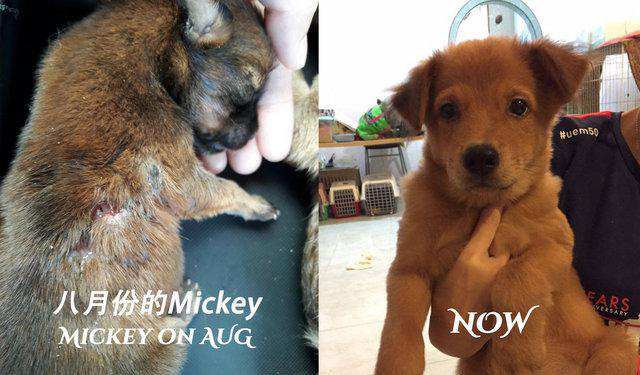

In [19]:
img.show()

In [25]:
15514+12456

27970

In [26]:
13804+16537

30341